In [ ]:
!/home/shaohyan/anaconda3/envs/tf38/bin/python ./exporter_main_v2.py \
    --trained_checkpoint_dir './training/' \
    --output_directory 'inference_graph' \
    --pipeline_config_path './model_config.config'

In [58]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import pandas as pd
from tqdm import tqdm

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [2]:
def load_image_into_numpy_array(path):
    img_data = tf.io.gfile.GFile(path, 'rb').read()
    image = Image.open(BytesIO(img_data))
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

In [3]:
labelmap_path = './labelmap.pbtxt'

category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)

In [4]:
tf.keras.backend.clear_session()
model = tf.saved_model.load(f'./inference_graph/saved_model')

In [60]:
def run_inference_for_single_image(model, image):
    image = np.asarray(image)
    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image)
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis,...]

    # Run inference
    model_fn = model.signatures['serving_default']
    output_dict = model_fn(input_tensor)

    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(output_dict.pop('num_detections'))
    output_dict = {key:value[0, :num_detections].numpy() for key,value in output_dict.items()}
    output_dict['num_detections'] = num_detections

    # detection_classes should be ints.
    output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)

    # Handle models with masks:
    if 'detection_masks' in output_dict:
        # Reframe the the bbox mask to the image size.
        detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(output_dict['detection_masks'], output_dict['detection_boxes'], image.shape[0], image.shape[1])      
        detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5, tf.uint8)
        output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()

    return output_dict

def get_predictions(model, image_np, max_bbox=4, score_threshold=1e-2):
    output_dict = run_inference_for_single_image(model, image_np)
    boxes = output_dict['detection_boxes'] * 512
    scores = output_dict['detection_scores']
    classes = output_dict['detection_classes']
    indices = tf.image.non_max_suppression(boxes, scores, max_output_size=max_bbox, iou_threshold=0.25, score_threshold=score_threshold, name=None).numpy()
    df_output = pd.DataFrame(boxes[indices], columns = ['ymin', 'xmin', 'ymax', 'xmax'])
    df_output['class'] = classes[indices]
    df_output['class'] = df_output['class'].map(lambda x: category_index[x]['name'])
    df_output['confidence'] = scores[indices]
    df_output['Image_ID'] = filename
    return df_output

In [68]:
## TODO: Multi processing not working

# import multiprocessing as mp
# from tqdm.contrib.concurrent import process_map

# def make_prediction(image_path):
#     filename = image_path.split('/')[-1].split(".")[0]
#     image_np = load_image_into_numpy_array(image_path)
#     return get_predictions(model, image_np)

# images_to_predict = glob.glob('../../Test_Images/*.jpg')
# df_list = process_map(make_prediction, images_to_predict, max_workers=mp.cpu_count())
# df_output = pd.concat(df_list)[['Image_ID', 'class', 'confidence', 'ymin', 'xmin', 'ymax', 'xmax']]

In [39]:
df_list = []
for idx, image_path in enumerate(tqdm(glob.glob('../../Test_Images/*.jpg'))):
    filename = image_path.split('/')[-1].split(".")[0]
    image_np = load_image_into_numpy_array(image_path)
    df_list.append(get_predictions(model, image_np))
df_output = pd.concat(df_list)[['Image_ID', 'class', 'confidence', 'ymin', 'xmin', 'ymax', 'xmax']]

100%|██████████| 931/931 [05:32<00:00,  2.80it/s]


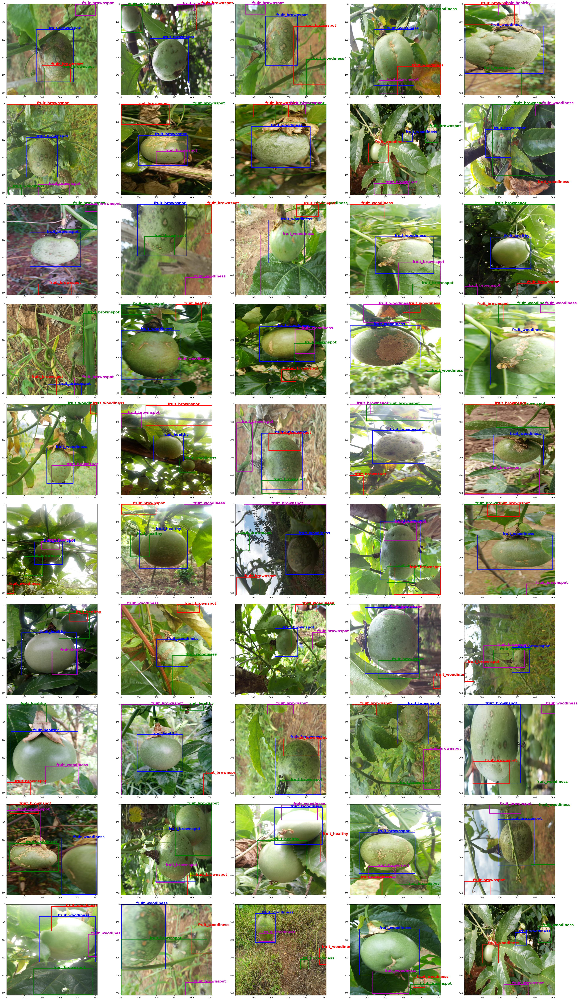

In [56]:
# Double Check
import sys 
sys.path.append('../..')
from helper import plot_sample_images, plot_sample_images_multi

plot_sample_images_multi(df_output, dir_path='../..', is_train=False, convert=True, top_n = 50, n_col = 5)

In [57]:
df_output.to_csv('../../submission.csv', encoding='utf-8', index=False)